In [42]:
import pandas as pd
import plotly.express as px

# Custom colors
colors = ['#66A54D', '#FF6D6D']  # Green for not canceled, red for canceled

# Load the cleaned data
df = pd.read_csv('hotel_bookings_cleaned.csv')

# Calculate the number of cancellations and non-cancellations
cancellation_counts = df['is_canceled'].value_counts().reset_index()
cancellation_counts.columns = ['is_canceled', 'count']
cancellation_counts['status'] = cancellation_counts['is_canceled'].map({0: 'Not Canceled', 1: 'Canceled'})

# Calculate percentages
total = cancellation_counts['count'].sum()
cancellation_counts['percentage'] = (cancellation_counts['count'] / total) * 100

# Create the bar chart using 'percentage' as y-axis
fig = px.bar(cancellation_counts, x='status', y='percentage', text='count',
             color='status', color_discrete_sequence=colors,
             title='Percentage of Bookings per Status')

# Update the text templates
fig.update_traces(texttemplate='%{text:.0f} bookings<br>%{y:.1f}%')

# Update the layout
fig.update_layout(
    xaxis_title='Booking Status',
    yaxis_title='Percentage of Bookings',
    plot_bgcolor='#FFFEF5',
    paper_bgcolor='#FFFEF5',
    font_color='#000000',
    title_x=0.5,
    # no legend
    showlegend=False
)

# Guardar la figura como HTML
fig.write_html('percentage_bookings_status.html', full_html=False, include_plotlyjs='cdn')
fig.show()

In [1]:
import pandas as pd
import plotly.figure_factory as ff

# Load the data
df = pd.read_csv('hotel_bookings_cleaned.csv')

# Rename variables for better understanding
renamed_columns = {
    'adr': 'Average Daily Rate',
    'adults': 'Number of Adults',
    'agent': 'Travel Agency ID',
    'arrival_date': 'Arrival Date',
    'arrival_date_week_number': 'Arrival Week Number',
    'assigned_room_type': 'Assigned Room Type',
    'babies': 'Number of Babies',
    'booking_changes': 'Booking Changes',
    'children': 'Number of Children',
    'company': 'Company ID',
    'country': 'Country of Origin',
    'customer_type': 'Customer Type',
    'days_in_waiting_list': 'Days in Waiting List',
    'deposit_type': 'Deposit Type',
    'distribution_channel': 'Distribution Channel',
    'is_canceled': 'Booking Canceled',
    'is_repeated_guest': 'Repeated Guest',
    'lead_time': 'Lead Time',
    'market_segment': 'Market Segment',
    'meal': 'Meal Type',
    'previous_bookings_not_canceled': 'Previous Bookings Not Canceled',
    'previous_cancellations': 'Previous Cancellations',
    'required_car_parking_spaces': 'Car Parking Spaces',
    'reservation_status': 'Reservation Status',
    'reservation_status_date': 'Reservation Status Date',
    'reserved_room_type': 'Reserved Room Type',
    'stays_in_weekend_nights': 'Weekend Stays',
    'stays_in_week_nights': 'Weekday Stays',
    'total_of_special_requests': 'Special Requests',
    'is_local': 'Local Guest',
}

# Rename columns in the DataFrame
df = df.rename(columns=renamed_columns)

# Automatically detect numeric columns
numeric_cols = df.select_dtypes(include=['number']).columns.tolist()

# Remove unwanted variables
numeric_cols.remove('Booking Canceled')  # Exclude target variable from features
if 'days_before_cancellation' in numeric_cols:
    numeric_cols.remove('days_before_cancellation')  # Exclude specific variable

# Compute the correlation matrix
corr_matrix = df[numeric_cols + ['Booking Canceled']].corr()

# Extract correlations with 'Booking Canceled' and sort in ascending order
cancellation_corr = corr_matrix['Booking Canceled'].drop('Booking Canceled').sort_values(ascending=True)

# Define the color range based on actual min and max values
color_range_min = cancellation_corr.min()
color_range_max = cancellation_corr.max()

# Create a heatmap using Plotly
fig = ff.create_annotated_heatmap(
    z=cancellation_corr.values.reshape(-1, 1),  # Single column for correlation
    x=['Correlation with Cancellation'],  # Single x-axis label
    y=cancellation_corr.index.tolist(),  # Feature names sorted
    colorscale='Blues',
    annotation_text=cancellation_corr.round(2).values.reshape(-1, 1),  # Annotate with correlation values
    showscale=False,  # Remove the color scale legend
    zmin=color_range_min,
    zmax=color_range_max
)

# Update layout for better visualization
fig.update_layout(
    title='Correlation Coefficient Between Numeric Features and Booking Cancellation',
    xaxis_title='',
    yaxis_title='',
    font=dict(size=12),
    title_x=0.5,
    plot_bgcolor='#FFFEF5',
    paper_bgcolor='#FFFEF5',
    height=800  # Increase vertical size
)

# Show the plot
fig.show()
fig.write_html('correlation_cancellation_variables.html', full_html=False, include_plotlyjs='cdn')

In [38]:
import pandas as pd
import plotly.express as px

# Load the data
df = pd.read_csv('hotel_bookings_cleaned.csv')

# Create lead_time bins
df['lead_time_bin'] = pd.cut(df['lead_time'], bins=[0, 30, 60, 90, 120, 180, 365, df['lead_time'].max()],
                             labels=['0-30', '31-60', '61-90', '91-120', '121-180', '181-365', '366+'])

# Calculate cancellation rate by lead_time_bin, specifying observed=False
lead_time_cancellation = df.groupby('lead_time_bin', observed=False)['is_canceled'].mean().reset_index()
lead_time_cancellation['cancellation_rate'] = lead_time_cancellation['is_canceled'] * 100

# Create the plot
fig = px.line(lead_time_cancellation, x='lead_time_bin', y='cancellation_rate',
              labels={'lead_time_bin': 'Lead Time (Days)', 'cancellation_rate': 'Cancellation Rate (%)'},
              title='Cancellation Rate by Lead Time',
              markers=True,
              color_discrete_sequence=['#6B9AC9'])

# Update layout
fig.update_layout(
    plot_bgcolor='#FFFEF5',
    paper_bgcolor='#FFFEF5',
    font_color='#000000',
    title_x=0.5
)

# Show the plot
fig.show()
fig.write_html('cancellation_by_lead_time.html', full_html=False, include_plotlyjs='cdn')

In [37]:
# Import necessary libraries
import pandas as pd
import plotly.express as px

# Load the data
df = pd.read_csv('hotel_bookings_cleaned.csv')

# Calculate the cancellation rate by the total number of special requests
special_requests_cancellation = df.groupby('total_of_special_requests')['is_canceled'].mean().reset_index()
special_requests_cancellation['cancellation_rate'] = special_requests_cancellation['is_canceled'] * 100

# Create the bar chart
fig = px.bar(
    special_requests_cancellation,
    x='total_of_special_requests',
    y='cancellation_rate',
    labels={
        'total_of_special_requests': 'Total Number of Special Requests',
        'cancellation_rate': 'Cancellation Rate (%)'
    },
    title='Cancellation Rate by Total Number of Special Requests',
    color_discrete_sequence=['#FFB6B1']  # Custom color
)

# Update the layout for better styling
fig.update_layout(
    plot_bgcolor='#FFFEF5',  # Background color for the plot
    paper_bgcolor='#FFFEF5',  # Background color for the entire figure
    font_color='#000000',  # Font color
    title_x=0.5  # Center-align the title
)

# Show the figure
fig.show()
fig.write_html('cancellation_by_special_request.html', full_html=False, include_plotlyjs='cdn')

In [36]:
import pandas as pd
import plotly.express as px
import pycountry

# Load the data
df = pd.read_csv('hotel_bookings_cleaned.csv')

# Convertir códigos de país a ISO-3 si es necesario
def get_iso3(country_code):
    try:
        if len(country_code) == 2:
            return pycountry.countries.get(alpha_2=country_code).alpha_3
        else:
            return country_code  # Asumimos que ya es ISO-3
    except:
        return None

df['country'] = df['country'].apply(get_iso3)

# Eliminar filas con valores nulos en 'country'
df = df.dropna(subset=['country'])

# Step 1: Convert 'arrival_date' to datetime format and create 'year_month'
df['arrival_date'] = pd.to_datetime(df['arrival_date'])
df['year_month'] = df['arrival_date'].dt.strftime('%Y-%m')

# Step 2: Calculate the cancellation rate by country and month
country_month_cancellation = df.groupby(['year_month', 'country'])['is_canceled'].mean().reset_index()
country_month_cancellation['cancellation_rate'] = country_month_cancellation['is_canceled'] * 100

# Step 3: Filter countries with at least 100 total bookings
country_counts = df['country'].value_counts().reset_index()
country_counts.columns = ['country', 'count']
countries_to_keep = country_counts[country_counts['count'] >= 100]['country']
country_month_cancellation = country_month_cancellation[country_month_cancellation['country'].isin(countries_to_keep)]

# Step 4: Calculate the overall average cancellation rate per country
total_avg_cancellation = df.groupby('country')['is_canceled'].mean().reset_index()
total_avg_cancellation['cancellation_rate'] = total_avg_cancellation['is_canceled'] * 100
total_avg_cancellation['year_month'] = 'Overall Average'

# Filter countries with at least 100 total bookings
total_avg_cancellation = total_avg_cancellation[total_avg_cancellation['country'].isin(countries_to_keep)]

# Combine with the original DataFrame
country_month_cancellation = pd.concat([country_month_cancellation, total_avg_cancellation], ignore_index=True)

# Step 5: Ensure 'year_month' is ordered and 'Overall Average' is last
months_sorted = sorted(country_month_cancellation['year_month'].unique())
months_sorted = [m for m in months_sorted if m != 'Overall Average'] + ['Overall Average']
country_month_cancellation['year_month'] = pd.Categorical(country_month_cancellation['year_month'], categories=months_sorted, ordered=True)

# Step 6: Remove any remaining NaN values
country_month_cancellation = country_month_cancellation.dropna(subset=['country', 'cancellation_rate'])

# Step 7: Create the interactive map with a fixed color range
fig = px.choropleth(
    country_month_cancellation,
    locations='country',
    locationmode='ISO-3',
    color='cancellation_rate',
    color_continuous_scale='Reds',
    hover_name='country',
    hover_data={'cancellation_rate': ':.1f'},
    animation_frame='year_month',
    title='Cancellation Rate by Country of Origin Over Time',
    labels={'cancellation_rate': 'Cancellation Rate (%)', 'year_month': 'Year-Month'},
)

# Update layout to fix the color scale from 0 to 100% and remove the colorbar
fig.update_layout(
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='natural earth',
        bgcolor='#FFFEF5'  # Match the background color of the plot
    ),
    plot_bgcolor='#FFFEF5',  # Background color for the plot
    paper_bgcolor='#FFFEF5',  # Background color for the entire figure
    font_color='#000000',
    title_x=0.5,
    height=650,  # Increase map size
    coloraxis=dict(
        cmin=0,
        cmax=100,
        showscale=False  # Ocultar la barra de color
    )
)

# Adjust the position of the date slider
fig.layout.sliders[0].pad = dict(r=10, t=0)  # Ajusta 't' para mover el slider hacia arriba
fig.layout.sliders[0]['len'] = 0.9  # Ajusta la longitud del slider si es necesario

# Optionally, adjust the position of the play and pause buttons
if 'updatemenus' in fig.layout:
    fig.layout.updatemenus[0].pad = dict(r=10, t=18)  # Ajusta 't' para mover los botones hacia arriba

# Show the figure
fig.show()
fig.write_html('cancellation_by_country_map.html', full_html=False, include_plotlyjs='cdn')

In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN
import plotly.express as px

# Step 1: Load the data
df = pd.read_csv('hotel_bookings_cleaned.csv')

# Step 2: Transform 'arrival_date' to day, month, and year
df['arrival_date'] = pd.to_datetime(df['arrival_date'], errors='coerce')
df['arrival_day'] = df['arrival_date'].dt.day
df['arrival_month'] = df['arrival_date'].dt.month
df['arrival_year'] = df['arrival_date'].dt.year

# Step 3: Update the list of features for clustering
features = [
    'lead_time', 'arrival_date_week_number', 'arrival_month',
    'stays_in_weekend_nights', 'stays_in_week_nights', 'adults', 'children',
    'babies', 'meal', 'country', 'market_segment', 'distribution_channel',
    'is_repeated_guest', 'previous_cancellations', 'previous_bookings_not_canceled',
    'reserved_room_type', 'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
    'company', 'days_in_waiting_list', 'customer_type', 'adr',
    'required_car_parking_spaces', 'total_of_special_requests',
    'reservation_status', 'is_local'
]

# Step 4: Filter the selected columns
df_clustering = df[features]

# Step 5: Handle missing values by dropping rows with NaNs
df_clustering = df_clustering.dropna()

# Step 6: Separate numerical and categorical variables
numeric_features = df_clustering.select_dtypes(include=['int64', 'float64']).columns
categorical_features = df_clustering.select_dtypes(include=['object']).columns

# Step 7: Preprocessing - Scaling and Encoding
# Define transformers for numerical and categorical features
numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder(drop='first')  # Produce dense output for t-SNE

# Combine transformers using ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

# Apply transformations to the data
X_preprocessed = preprocessor.fit_transform(df_clustering)

# Step 8: Dimensionality Reduction using t-SNE
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
# t-SNE works on dense matrices; X_preprocessed is already dense
X_dense = X_preprocessed.toarray()
X_tsne = tsne.fit_transform(X_dense)

# Step 9: Clustering with DBSCAN
# Create a DataFrame to hold t-SNE results
df_tsne = pd.DataFrame()
df_tsne['TSNE1'] = X_tsne[:, 0]
df_tsne['TSNE2'] = X_tsne[:, 1]

# Apply DBSCAN clustering on t-SNE coordinates
dbscan = DBSCAN(eps=8, min_samples=500)
clusters = dbscan.fit_predict(X_tsne)
df_tsne['cluster'] = clusters

# Step 10: Add cluster labels to the original DataFrame
# Reset indices to ensure alignment
df_clustering = df_clustering.reset_index(drop=True)
df_tsne = df_tsne.reset_index(drop=True)
df_clustering['cluster'] = df_tsne['cluster']

# Merge 'cluster' back into the original DataFrame 'df'
df = df.reset_index(drop=True)
df['cluster'] = np.nan  # Initialize 'cluster' column with NaNs
df.loc[df_clustering.index, 'cluster'] = df_clustering['cluster']

# Convert 'cluster' to integer type
df['cluster'] = df['cluster'].astype('Int64')  # Use 'Int64' to allow for NaNs

# Step 11: Calculate cancellation rate per cluster
cancellation_rate = df.groupby('cluster')['is_canceled'].mean() * 100
cancellation_rate = cancellation_rate.reset_index()
cancellation_rate.columns = ['cluster', 'cancellation_rate']

# Step 12: Calculate mean values of numerical variables per cluster
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns.drop('cluster', errors='ignore')
cluster_means = df.groupby('cluster')[numeric_cols].mean().reset_index()

# Step 13: Create detailed descriptions for each cluster
# Existing cluster descriptions from your previous analysis
cluster_descriptions = {
    -1: "Early bookers, adults without children, minimal special requests",
    0: "Moderate lead time, couples without children, some special requests",
    1: "Families booking in advance with children, several special requests",
    2: "Short lead time, small families with children, high special requests",
    3: "Moderate lead time, small groups without children, significant special requests",
    4: "Short lead time, solo travelers or couples, some special requests",
    5: "Last-minute bookings by adults, minimal special requests",
    6: "Families booking in advance, large group size, high special requests",
    7: "Families with children, moderate lead time, numerous special requests",
    8: "Families booking in advance with multiple children, requiring special requests",
    9: "Short lead time, small groups with children, some special requests",
    10: "Very last-minute bookings by adults, minimal special requests",
    11: "Short lead time, adults without children, few special requests",
    12: "Groups booking far in advance with children, moderate special requests",
    13: "Large families booking very early, some special requests",
    14: "Returning guests booking on short notice, some special requests",
    15: "Returning guests with children, high special requests",
    16: "Moderate lead time, small groups, minimal special requests"
}

# Combine the detailed descriptions with the cancellation rate
def create_description(cluster_label):
    cancel_rate_row = cancellation_rate[cancellation_rate['cluster'] == cluster_label]
    if not cancel_rate_row.empty:
        cancel_rate = cancel_rate_row['cancellation_rate'].values[0]
        description = cluster_descriptions.get(cluster_label, "No description available")
        full_description = f"{description}. Average cancellation rate: {cancel_rate:.2f}%"
    else:
        full_description = "No data available"
    return full_description

# Create a DataFrame with cluster descriptions
cluster_info = pd.DataFrame({
    'cluster': cancellation_rate['cluster'],
    'cancellation_rate': cancellation_rate['cancellation_rate'],
    'description': cancellation_rate['cluster'].apply(create_description)
})

# Ensure 'cluster' is of the same type for merging
cluster_info['cluster'] = cluster_info['cluster'].astype('Int64')
df_tsne['cluster'] = df_tsne['cluster'].astype('Int64')

# Merge DataFrames
df_plot = pd.merge(df_tsne, cluster_info, on='cluster', how='left')

# Convert 'cluster' to string for categorical coloring
df_plot['cluster'] = df_plot['cluster'].astype(str)



In [35]:
# Step 14: Create a custom color palette
# Base colors provided
base_colors = [
    '#BFEEB6',  # Light Green
    '#66A54D',  # Dark Green
    '#B5CCDF',  # Light Blue
    '#6B9AC9',  # Dark Blue
    '#FFB6B1',  # Light Red
    '#FF6D6D',  # Dark Red
]

# Generate additional colors using Plotly's qualitative color sequences
additional_colors = px.colors.qualitative.Alphabet

# Combine base colors and additional colors
custom_colors = base_colors + additional_colors

# Ensure we have enough colors
num_clusters = df_plot['cluster'].nunique()
if num_clusters > len(custom_colors):
    # Repeat the colors if necessary (unlikely, but just in case)
    custom_colors = (custom_colors * ((num_clusters // len(custom_colors)) + 1))[:num_clusters]

# Create a color mapping for clusters
cluster_labels = sorted(df_plot['cluster'].unique(), key=lambda x: int(x) if x != 'nan' else float('inf'))
color_map = dict(zip(cluster_labels, custom_colors[:len(cluster_labels)]))

# Step 15: Create the scatter plot without axes and legend
fig = px.scatter(
    df_plot,
    x='TSNE1',
    y='TSNE2',
    color='cluster',
    hover_data=['description'],  # Only show the description
    labels={'TSNE1': '', 'TSNE2': '', 'cluster': ''},
    color_discrete_map=color_map,
    title='Clustering Customers by Cancellation Behavior', 
)

# Update the hover template to include only the description
fig.update_traces(
    hovertemplate="%{customdata[0]}",
    marker=dict(size=5)
)

# Remove axes labels and ticks
fig.update_xaxes(visible=False)
fig.update_yaxes(visible=False)

# Remove the clustering legend
fig.update_layout(
    showlegend=False,
    plot_bgcolor='#FFFEF5',
    paper_bgcolor='#FFFEF5',
    font_color='#000000',
    title_x=0.5,
    height=800,
    font=dict(
        size=12,
        color='#000000'
    ),
    margin=dict(l=0, r=0, t=50, b=0)
)

# Show the figure
fig.show()
fig.write_html('clustering.html', full_html=False, include_plotlyjs='cdn')

In [1]:
import pandas as pd
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer

# Cargar los datos
df = pd.read_csv('hotel_bookings_cleaned.csv')

# Transformar 'arrival_date' a día, mes y año
df['arrival_date'] = pd.to_datetime(df['arrival_date'], errors='coerce')
df['arrival_day'] = df['arrival_date'].dt.day
df['arrival_month'] = df['arrival_date'].dt.month
df['arrival_year'] = df['arrival_date'].dt.year

# Actualizar la lista de características
features = ['lead_time', 'arrival_date_week_number',  'arrival_month', # 'arrival_year', 'arrival_day',
           'stays_in_weekend_nights', 'stays_in_week_nights', 'adults', 'children',
           'babies', 'meal', 'country', 'market_segment', 'distribution_channel',
           'is_repeated_guest', 'previous_cancellations',
           'previous_bookings_not_canceled', 'reserved_room_type',
           'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
           'company', 'days_in_waiting_list', 'customer_type', 'adr',
           'required_car_parking_spaces', 'total_of_special_requests',
           'reservation_status', 'is_local']

# Filtrar las columnas seleccionadas
df_clustering = df[features]

# Manejar valores nulos
df_clustering = df_clustering.dropna()

# Separar variables numéricas y categóricas
numeric_features = df_clustering.select_dtypes(include=['int64', 'float64']).columns
categorical_features = df_clustering.select_dtypes(include=['object']).columns

# Preprocesamiento: Escalado y Codificación
numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder(drop='first')  # Evita multicolinealidad

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)])

# Aplicar transformaciones
X_preprocessed = preprocessor.fit_transform(df_clustering)



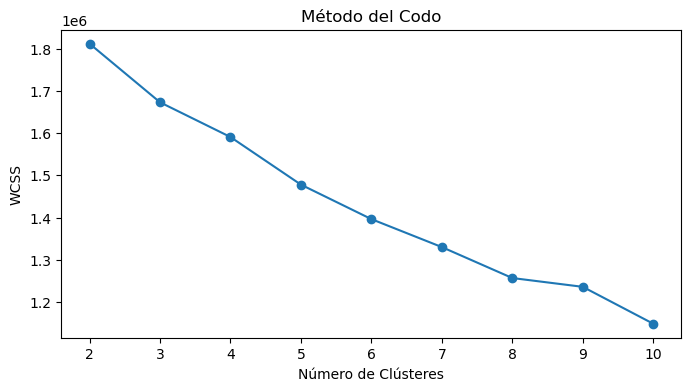

In [82]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Método del Codo
wcss = []  # Suma de cuadrados intra-clúster

for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(X_preprocessed)
    wcss.append(kmeans.inertia_)

# Graficar el Método del Codo
plt.figure(figsize=(8, 4))
plt.plot(range(2, 11), wcss, marker='o')
plt.title('Método del Codo')
plt.xlabel('Número de Clústeres')
plt.ylabel('WCSS')
plt.show()



In [ ]:
# Aplicar K-Means con K=3
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(X_preprocessed)

# Añadir los clústeres al DataFrame de clustering
df_clustering['cluster'] = clusters

# Remove cluster column from df
if 'cluster' in df.columns:
    df = df.drop('cluster', axis=1)

# Unir 'cluster' al DataFrame original
df = df.join(df_clustering['cluster'])

# Opcional: Manejar valores NaN en 'cluster'
df['cluster'] = df['cluster'].fillna(-1)

In [84]:
# Seleccionar columnas numéricas
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns

# Excluir la columna 'cluster' si está en las columnas numéricas
numeric_cols = numeric_cols.drop('cluster', errors='ignore')

# Calcular el perfil de clúster solo con columnas numéricas
cluster_profile = df.groupby('cluster')[numeric_cols].mean()

# Añadir el conteo de observaciones por clúster
cluster_profile['count'] = df.groupby('cluster').size()

# Calcular la tasa de cancelación por clúster
cluster_profile['cancellation_rate'] = df.groupby('cluster')['is_canceled'].mean() * 100

# Mostrar el perfil de clúster
print(cluster_profile)

         is_canceled  lead_time  arrival_date_week_number  \
cluster                                                     
0           0.185102  79.612867                 28.845372   
1           0.245020  91.569416                 26.763576   
2           0.384915  68.559061                 27.233276   

         stays_in_weekend_nights  stays_in_week_nights    adults  children  \
cluster                                                                      
0                       1.187359              3.059819  2.001129  0.216704   
1                       1.092549              2.794033  1.937488  0.132362   
2                       0.793338              2.224681  1.739800  0.106489   

           babies  is_repeated_guest  previous_cancellations  \
cluster                                                        
0        1.034989           0.009029                0.009029   
1        0.000000           0.001365                0.000667   
2        0.000000           0.099827           

In [85]:
# Variables categóricas de interés
categorical_vars = categorical_features.tolist() # ['customer_type', 'deposit_type', 'market_segment', 'distribution_channel']

for var in categorical_vars:
    print(f'\nDistribución de {var} por clúster:')
    print(pd.crosstab(df[var], df['cluster'], normalize='columns') * 100)


Distribución de meal por clúster:
cluster          0          1          2
meal                                    
BB       71.444695  75.620617  81.429065
FB        2.708804   0.167567   0.914739
HB       19.977427  10.249488  11.625820
No Meal   1.805869   0.423571   1.042458
SC        4.063205  13.538758   4.987919

Distribución de country por clúster:
cluster         0         1         2
country                              
ABW      0.000000  0.003103  0.000000
AGO      0.564334  0.502700  0.041422
AIA      0.000000  0.001552  0.000000
ALB      0.112867  0.017067  0.000000
AND      0.000000  0.010861  0.000000
...           ...       ...       ...
VGB      0.000000  0.001552  0.000000
VNM      0.000000  0.012412  0.000000
ZAF      0.000000  0.121020  0.003452
ZMB      0.000000  0.003103  0.000000
ZWE      0.000000  0.006206  0.000000

[177 rows x 3 columns]

Distribución de market_segment por clúster:
cluster                 0          1          2
market_segment               

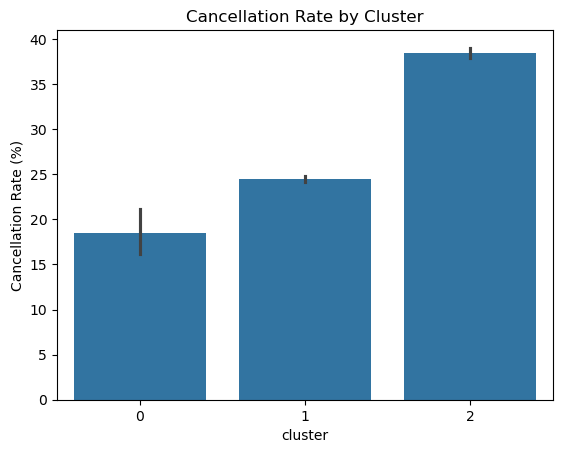

In [86]:
import seaborn as sns

sns.barplot(x='cluster', y='is_canceled', data=df, estimator=lambda x: sum(x)/len(x) * 100)
plt.ylabel('Cancellation Rate (%)')
plt.title('Cancellation Rate by Cluster')
plt.show()

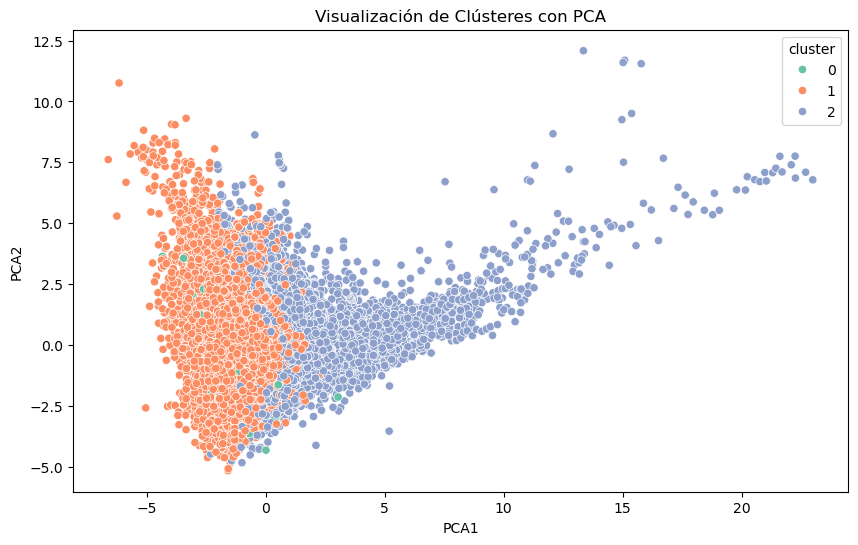

In [87]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Reducir a 2 componentes principales
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_preprocessed)

# Crear un DataFrame para visualización
df_visualization = pd.DataFrame()
df_visualization['PCA1'] = X_pca[:, 0]
df_visualization['PCA2'] = X_pca[:, 1]
df_visualization['cluster'] = df['cluster']

# Graficar
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PCA1', y='PCA2', hue='cluster', data=df_visualization, palette='Set2')
plt.title('Visualización de Clústeres con PCA')
plt.show()

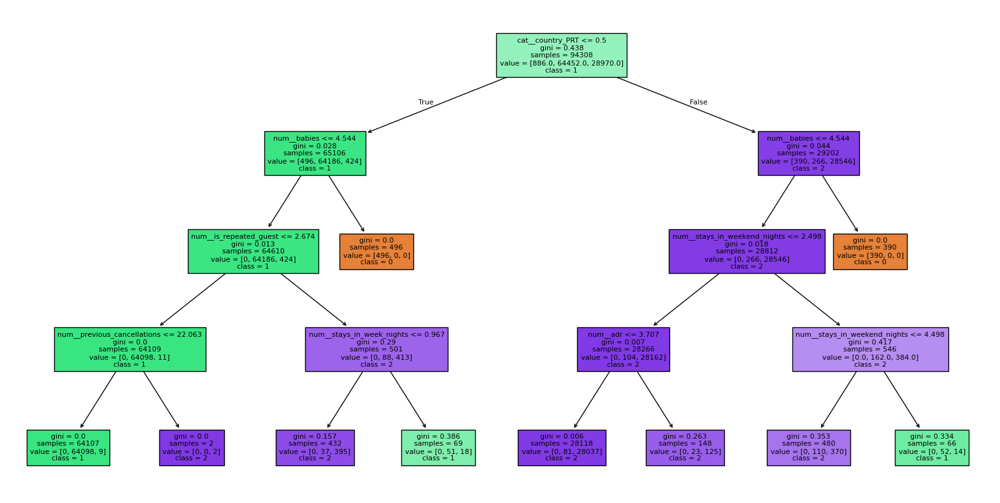

In [79]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree

# Entrenar el árbol de decisión
dt = DecisionTreeClassifier(max_depth=4, random_state=42)
dt.fit(X_preprocessed, df['cluster'])

# Visualizar el árbol
plt.figure(figsize=(20, 10))
plot_tree(dt, feature_names=preprocessor.get_feature_names_out(), class_names=[str(i) for i in dt.classes_],
          filled=True, fontsize=8)
plt.show()

In [90]:
from sklearn.metrics import silhouette_score

score = silhouette_score(X_preprocessed, clusters)
print(f'Silhouette Score: {score}')

In [91]:
print(f'Silhouette Score: {score}')

Silhouette Score: 0.1376023479842453


         is_canceled   lead_time  arrival_date_week_number  \
cluster                                                      
-1          0.283801   82.888200                 27.019099   
 0          1.000000  198.166667                 26.000000   
 1          1.000000   76.125000                 31.250000   
 2          1.000000   56.666667                 33.166667   
 3          1.000000  121.400000                 28.400000   
...              ...         ...                       ...   
 766        1.000000  328.538462                 37.076923   
 767        1.000000  328.500000                 37.500000   
 768        1.000000  307.454545                 34.181818   
 769        1.000000  294.125000                 32.500000   
 770        1.000000  311.625000                 34.375000   

         stays_in_weekend_nights  stays_in_week_nights    adults  children  \
cluster                                                                      
-1                      1.019709     

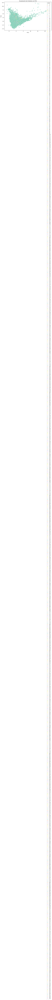

In [ ]:
from sklearn.cluster import DBSCAN

dbscan = DBSCAN(eps=0.5, min_samples=5)
clusters = dbscan.fit_predict(X_preprocessed)

# Añadir los clústeres al DataFrame
df_clustering['cluster'] = clusters





# Remove cluster column from df
if 'cluster' in df.columns:
    df = df.drop('cluster', axis=1)

# Unir 'cluster' al DataFrame original
df = df.join(df_clustering['cluster'])

# Opcional: Manejar valores NaN en 'cluster'
df['cluster'] = df['cluster'].fillna(-1)

# Seleccionar columnas numéricas
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns

# Excluir la columna 'cluster' si está en las columnas numéricas
numeric_cols = numeric_cols.drop('cluster', errors='ignore')

# Calcular el perfil de clúster solo con columnas numéricas
cluster_profile = df.groupby('cluster')[numeric_cols].mean()

# Añadir el conteo de observaciones por clúster
cluster_profile['count'] = df.groupby('cluster').size()

# Calcular la tasa de cancelación por clúster
cluster_profile['cancellation_rate'] = df.groupby('cluster')['is_canceled'].mean() * 100

# Mostrar el perfil de clúster
print(cluster_profile)

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Reducir a 2 componentes principales
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_preprocessed)

# Crear un DataFrame para visualización
df_visualization = pd.DataFrame()
df_visualization['PCA1'] = X_pca[:, 0]
df_visualization['PCA2'] = X_pca[:, 1]
df_visualization['cluster'] = df['cluster']

# Graficar
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PCA1', y='PCA2', hue='cluster', data=df_visualization, palette='Set2')
plt.title('Visualización de Clústeres con PCA')
plt.show()


In [ ]:
from sklearn.metrics import silhouette_score

score = silhouette_score(X_preprocessed, clusters)
print(f'Silhouette Score: {score}')

In [ ]:
from sklearn.cluster import AgglomerativeClustering

hierarchical = AgglomerativeClustering(n_clusters=3)
clusters = hierarchical.fit_predict(X_preprocessed.toarray())

# Añadir los clústeres al DataFrame
df_clustering['cluster'] = clusters




# Remove cluster column from df
if 'cluster' in df.columns:
    df = df.drop('cluster', axis=1)

# Unir 'cluster' al DataFrame original
df = df.join(df_clustering['cluster'])

# Opcional: Manejar valores NaN en 'cluster'
df['cluster'] = df['cluster'].fillna(-1)

# Seleccionar columnas numéricas
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns

# Excluir la columna 'cluster' si está en las columnas numéricas
numeric_cols = numeric_cols.drop('cluster', errors='ignore')

# Calcular el perfil de clúster solo con columnas numéricas
cluster_profile = df.groupby('cluster')[numeric_cols].mean()

# Añadir el conteo de observaciones por clúster
cluster_profile['count'] = df.groupby('cluster').size()

# Calcular la tasa de cancelación por clúster
cluster_profile['cancellation_rate'] = df.groupby('cluster')['is_canceled'].mean() * 100

# Mostrar el perfil de clúster
print(cluster_profile)

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Reducir a 2 componentes principales
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_preprocessed)

# Crear un DataFrame para visualización
df_visualization = pd.DataFrame()
df_visualization['PCA1'] = X_pca[:, 0]
df_visualization['PCA2'] = X_pca[:, 1]
df_visualization['cluster'] = df['cluster']

# Graficar
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PCA1', y='PCA2', hue='cluster', data=df_visualization, palette='Set2')
plt.title('Visualización de Clústeres con PCA')
plt.show()

In [ ]:
from sklearn.metrics import silhouette_score

score = silhouette_score(X_preprocessed, clusters)
print(f'Silhouette Score: {score}')

         is_canceled   lead_time  arrival_date_week_number  \
cluster                                                      
0           0.296039   83.784979                 26.908819   
1           0.269475  112.186866                 27.525362   
2           0.207068   39.759307                 26.042031   

         stays_in_weekend_nights  stays_in_week_nights    adults  children  \
cluster                                                                      
0                       1.045907              2.708041  1.940185  0.143971   
1                       0.937591              2.494384  1.729167  0.052536   
2                       0.533025              1.714702  1.323383  0.013553   

           babies  is_repeated_guest  previous_cancellations  \
cluster                                                        
0        0.011842           0.016000                0.013404   
1        0.000000           0.012500                0.028170   
2        0.000000           0.276377      

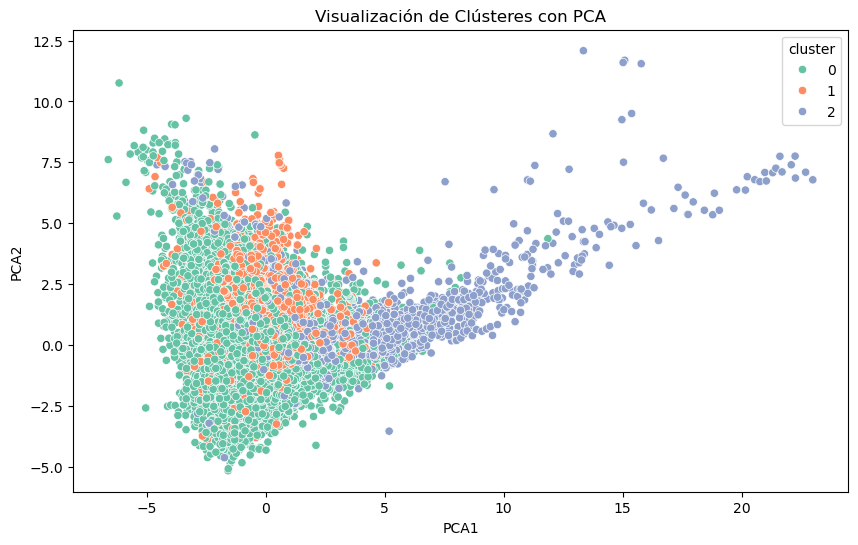

In [6]:
from sklearn.mixture import GaussianMixture
import seaborn as sns
import matplotlib.pyplot as plt

gmm = GaussianMixture(n_components=3, random_state=42)
clusters = gmm.fit_predict(X_preprocessed.toarray())

# Añadir los clústeres al DataFrame
df_clustering['cluster'] = clusters





# Remove cluster column from df
if 'cluster' in df.columns:
    df = df.drop('cluster', axis=1)

# Unir 'cluster' al DataFrame original
df = df.join(df_clustering['cluster'])

# Opcional: Manejar valores NaN en 'cluster'
df['cluster'] = df['cluster'].fillna(-1)

# Seleccionar columnas numéricas
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns

# Excluir la columna 'cluster' si está en las columnas numéricas
numeric_cols = numeric_cols.drop('cluster', errors='ignore')

# Calcular el perfil de clúster solo con columnas numéricas
cluster_profile = df.groupby('cluster')[numeric_cols].mean()

# Añadir el conteo de observaciones por clúster
cluster_profile['count'] = df.groupby('cluster').size()

# Calcular la tasa de cancelación por clúster
cluster_profile['cancellation_rate'] = df.groupby('cluster')['is_canceled'].mean() * 100

# Mostrar el perfil de clúster
print(cluster_profile)

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Reducir a 2 componentes principales
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_preprocessed)

# Crear un DataFrame para visualización
df_visualization = pd.DataFrame()
df_visualization['PCA1'] = X_pca[:, 0]
df_visualization['PCA2'] = X_pca[:, 1]
df_visualization['cluster'] = df['cluster']

# Graficar
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PCA1', y='PCA2', hue='cluster', data=df_visualization, palette='Set2')
plt.title('Visualización de Clústeres con PCA')
plt.show()

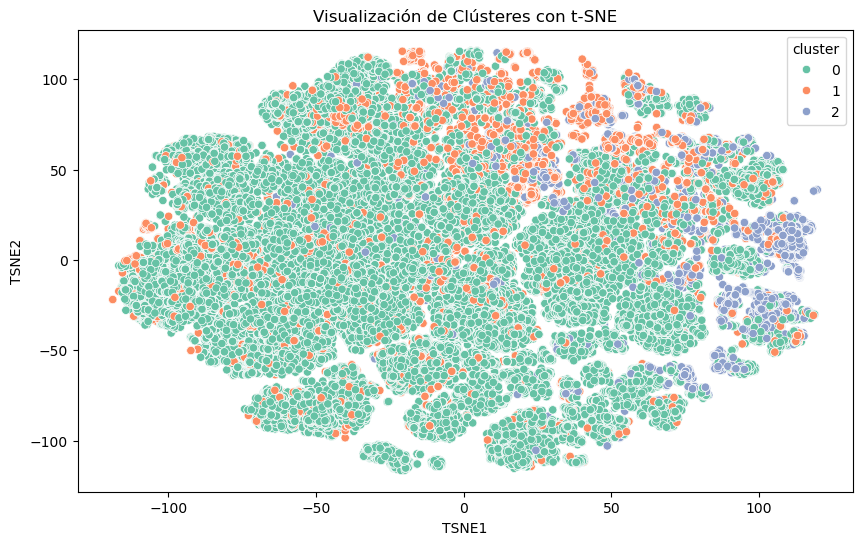

In [7]:
from sklearn.manifold import TSNE

# Reducir a 2 dimensiones con t-SNE
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
# Convertir a matriz densa
X_dense = X_preprocessed.toarray()

# Aplicar t-SNE
X_tsne = tsne.fit_transform(X_dense)

# Crear un DataFrame para visualización
df_tsne = pd.DataFrame()
df_tsne['TSNE1'] = X_tsne[:, 0]
df_tsne['TSNE2'] = X_tsne[:, 1]
df_tsne['cluster'] = df_clustering['cluster'].values

# Graficar
plt.figure(figsize=(10, 6))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='cluster', data=df_tsne, palette='Set2')
plt.title('Visualización de Clústeres con t-SNE')
plt.show()

In [ ]:
from sklearn.metrics import silhouette_score

score = silhouette_score(X_preprocessed, clusters)
print(f'Silhouette Score: {score}')

In [11]:
import hdbscan

# Aplicar HDBSCAN sobre los datos preprocesados
clusterer = hdbscan.HDBSCAN(min_cluster_size=50)
clusters = clusterer.fit_predict(X_preprocessed)

# Añadir los clústeres al DataFrame
df_clustering['cluster'] = clusters

ModuleNotFoundError: No module named 'hdbscan'

In [2]:
import umap
import hdbscan

# Paso 1: Reducir la dimensionalidad con UMAP
reducer = umap.UMAP(n_components=15, random_state=42)
X_umap = reducer.fit_transform(X_preprocessed)

# Paso 2: Aplicar HDBSCAN
clusterer = hdbscan.HDBSCAN(min_cluster_size=50)
clusters = clusterer.fit_predict(X_umap)

# Añadir los clústeres al DataFrame
df_clustering['cluster'] = clusters

# Paso 3: Visualizar los clústeres en 2D con UMAP
# Reducir a 2 dimensiones para visualización
reducer_2d = umap.UMAP(n_components=2, random_state=42)
X_umap_2d = reducer_2d.fit_transform(X_umap)

# Crear DataFrame para visualización
df_umap = pd.DataFrame()
df_umap['UMAP1'] = X_umap_2d[:, 0]
df_umap['UMAP2'] = X_umap_2d[:, 1]
df_umap['cluster'] = clusters

# Graficar
plt.figure(figsize=(10, 6))
sns.scatterplot(x='UMAP1', y='UMAP2', hue='cluster', data=df_umap, palette='tab10')
plt.title('Clústeres identificados por HDBSCAN en el espacio UMAP 2D')
plt.show()

ModuleNotFoundError: No module named 'umap'

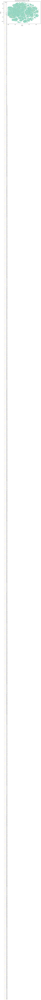

In [9]:
# Crear un DataFrame para visualización
df_tsne = pd.DataFrame()
df_tsne['TSNE1'] = X_tsne[:, 0]
df_tsne['TSNE2'] = X_tsne[:, 1]
df_tsne['cluster'] = df_clustering['cluster'].values

# Graficar
plt.figure(figsize=(10, 6))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='cluster', data=df_tsne, palette='Set2')
plt.title('Visualización de Clústeres con t-SNE')
plt.show()

In [2]:
from sklearn.manifold import TSNE

# Reducir a 2 dimensiones con t-SNE
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
# Convertir a matriz densa
X_dense = X_preprocessed.toarray()

# Aplicar t-SNE
X_tsne = tsne.fit_transform(X_dense)

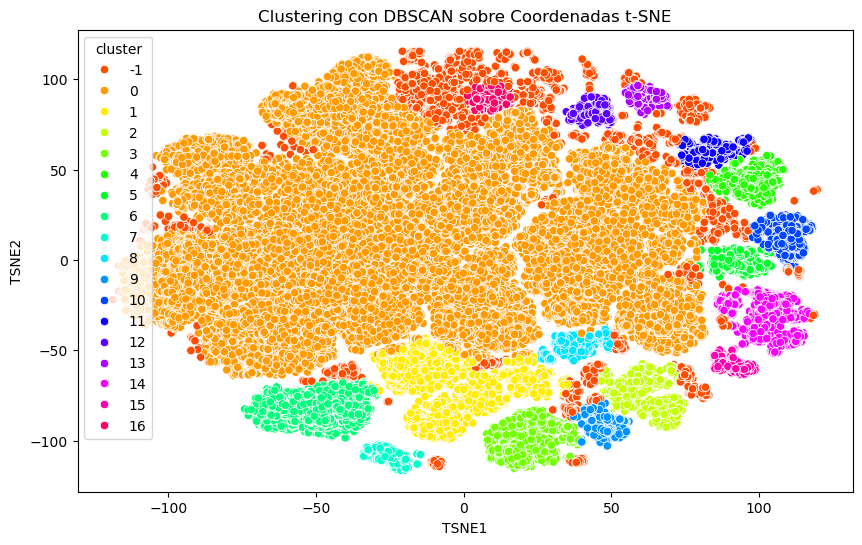


Tasa de cancelación por clúster (%):
cluster
-1     25.570991
 0     30.132186
 1     43.440549
 2      0.000000
 3      0.000000
 4     37.249071
 5     18.859649
 6     41.762821
 7     22.162162
 8     49.386845
 9      0.000000
 10    19.884010
 11    30.267380
 12    32.203390
 13    99.648506
 14     7.074830
 15     0.361664
 16     0.744879
Name: is_canceled, dtype: float64

Medias de variables numéricas por clúster:


,cluster,is_canceled,lead_time,arrival_date_week_number,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,days_before_cancellation,is_local
0,-1,0.255710,133.774900,27.624794,0.824935,2.293030,1.804803,0.120085,0.017189,0.025430,0.193666,0.502001,0.398281,5.389569,95.948823,0.147045,0.392748,-71.421271,0.410643
1,0,0.301322,83.264176,26.783173,1.086662,2.783515,1.890584,0.009502,0.000000,0.000049,0.000277,0.003244,0.222776,0.016967,103.816817,0.000049,0.713722,-63.307027,0.231366
2,1,0.434405,98.541742,27.013191,1.123780,2.871702,1.990604,1.524756,0.000000,0.000000,0.004518,0.001446,0.288038,0.003614,165.120022,0.023130,0.803036,-74.242928,0.135707
3,2,0.000000,52.548700,28.159102,0.877104,2.431413,2.006119,0.240694,0.000000,0.001020,0.000000,0.071902,0.449771,0.063233,127.012820,1.011219,0.818460,NaN,0.990311
4,3,0.000000,66.586913,27.674829,1.001606,2.531112,2.032919,0.002810,0.000000,0.000000,0.000000,0.001606,0.233641,0.000000,110.798105,1.000401,1.015255,NaN,0.000000
5,4,0.372491,38.301859,25.404461,0.626766,1.851301,1.000000,0.000000,0.000000,0.000000,0.000000,0.018587,0.157621,0.014870,84.787621,0.000000,0.687732,-36.684631,1.000000
6,5,0.188596,12.339912,24.559211,0.361842,1.408991,1.028509,0.016447,0.000000,0.000000,0.001096,0.026316,0.333333,0.000000,79.670954,0.000000,0.184211,-14.116279,1.000000
7,6,0.417628,99.609295,26.997115,0.944231,2.506090,3.004808,0.001282,0.000000,0.000000,0.000000,0.002244,0.190385,0.000000,156.888083,0.000000,0.929487,-75.747506,0.000000
8,7,0.221622,79.756757,28.947297,1.224324,3.109459,1.997297,0.197297,1.041892,0.010811,0.010811,0.008108,0.854054,0.039189,119.937459,0.008108,1.509459,-57.359756,0.414865
9,8,0.493868,87.940914,28.245262,1.220736,3.064660,2.065775,1.001115,0.000000,0.000000,0.001115,0.004459,0.357860,0.000000,152.847960,0.000000,0.975474,-67.654628,1.000000



Distribución de hotel por clúster:

Clúster -1:


,hotel,proportion
0,City Hotel,0.619849
1,Resort Hotel,0.380151



Clúster 0:


,hotel,proportion
2,City Hotel,0.650791
3,Resort Hotel,0.349209



Clúster 1:


,hotel,proportion
4,City Hotel,0.652873
5,Resort Hotel,0.347127



Clúster 2:


,hotel,proportion
6,Resort Hotel,0.838348
7,City Hotel,0.161652



Clúster 3:


,hotel,proportion
8,Resort Hotel,0.68045
9,City Hotel,0.31955



Clúster 4:


,hotel,proportion
10,City Hotel,0.579926
11,Resort Hotel,0.420074



Clúster 5:


,hotel,proportion
12,Resort Hotel,0.570175
13,City Hotel,0.429825



Clúster 6:


,hotel,proportion
14,City Hotel,0.958974
15,Resort Hotel,0.041026



Clúster 7:


,hotel,proportion
16,Resort Hotel,0.563514
17,City Hotel,0.436486



Clúster 8:


,hotel,proportion
18,Resort Hotel,0.588629
19,City Hotel,0.411371



Clúster 9:


,hotel,proportion
20,Resort Hotel,0.725806
21,City Hotel,0.274194



Clúster 10:


,hotel,proportion
22,Resort Hotel,0.5029
23,City Hotel,0.4971



Clúster 11:


,hotel,proportion
24,City Hotel,0.674866
25,Resort Hotel,0.325134



Clúster 12:


,hotel,proportion
26,City Hotel,0.893683
27,Resort Hotel,0.106317



Clúster 13:


,hotel,proportion
28,City Hotel,0.641476
29,Resort Hotel,0.358524



Clúster 14:


,hotel,proportion
30,Resort Hotel,0.54059
31,City Hotel,0.45941



Clúster 15:


,hotel,proportion
32,Resort Hotel,0.661844
33,City Hotel,0.338156



Clúster 16:


,hotel,proportion
34,City Hotel,0.662942
35,Resort Hotel,0.337058



Distribución de meal por clúster:

Clúster -1:


,meal,proportion
0,BB,0.776666
1,HB,0.180598
2,SC,0.019779
3,No Meal,0.017306
4,FB,0.005651



Clúster 0:


,meal,proportion
5,BB,0.741414
6,SC,0.151940
7,HB,0.098381
8,No Meal,0.004971
9,FB,0.003292



Clúster 1:


,meal,proportion
10,BB,0.857969
11,HB,0.122335
12,SC,0.015540
13,FB,0.002168
14,No Meal,0.001988



Clúster 2:


,meal,proportion
15,BB,0.784294
16,HB,0.167772
17,FB,0.018358
18,SC,0.016828
19,No Meal,0.012749



Clúster 3:


,meal,proportion
20,BB,0.795263
21,HB,0.136491
22,SC,0.065837
23,FB,0.001606
24,No Meal,0.000803



Clúster 4:


,meal,proportion
25,BB,0.796283
26,SC,0.165056
27,HB,0.031227
28,No Meal,0.005204
29,FB,0.002230



Clúster 5:


,meal,proportion
30,BB,0.936404
31,SC,0.028509
32,HB,0.023026
33,FB,0.012061



Clúster 6:


,meal,proportion
34,BB,0.935256
35,HB,0.050000
36,SC,0.014423
37,No Meal,0.000321



Clúster 7:


,meal,proportion
38,BB,0.727027
39,HB,0.183784
40,SC,0.048649
41,FB,0.025676
42,No Meal,0.014865



Clúster 8:


,meal,proportion
43,BB,0.665552
44,HB,0.258640
45,FB,0.032330
46,SC,0.027871
47,No Meal,0.015608



Clúster 9:


,meal,proportion
48,BB,0.837469
49,HB,0.140199
50,SC,0.017370
51,FB,0.002481
52,No Meal,0.002481



Clúster 10:


,meal,proportion
53,BB,0.984258
54,HB,0.013256
55,FB,0.001657
56,SC,0.000829



Clúster 11:


,meal,proportion
57,BB,0.896257
58,HB,0.093048
59,SC,0.009626
60,FB,0.001070



Clúster 12:


,meal,proportion
61,BB,0.718028
62,HB,0.244992
63,No Meal,0.035439
64,FB,0.001541



Clúster 13:


,meal,proportion
65,BB,0.776801
66,HB,0.189807
67,FB,0.019332
68,SC,0.010545
69,No Meal,0.003515



Clúster 14:


,meal,proportion
70,BB,0.943764
71,HB,0.030839
72,SC,0.021315
73,No Meal,0.002721
74,FB,0.001361



Clúster 15:


,meal,proportion
75,BB,0.918626
76,HB,0.070524
77,No Meal,0.005425
78,FB,0.003617
79,SC,0.001808



Clúster 16:


,meal,proportion
80,BB,0.808194
81,HB,0.108007
82,No Meal,0.059590
83,FB,0.020484
84,SC,0.003724



Distribución de country por clúster:

Clúster -1:


,country,proportion
0,PRT,0.410643
1,GBR,0.110313
2,FRA,0.082529
3,DEU,0.082058
4,ESP,0.054745
...,...,...
87,LCA,0.000118
88,PAN,0.000118
89,PYF,0.000118
90,SUR,0.000118



Clúster 0:


,country,proportion
92,PRT,0.231366
93,GBR,0.144524
94,FRA,0.115381
95,ESP,0.080012
96,DEU,0.074715
...,...,...
254,SMR,0.000016
255,TMP,0.000016
256,UMI,0.000016
257,VGB,0.000016



Clúster 1:


,country,proportion
259,PRT,0.135707
260,GBR,0.134261
261,ESP,0.124142
262,FRA,0.114565
263,DEU,0.049151
...,...,...
358,SRB,0.000181
359,SUR,0.000181
360,TZA,0.000181
361,VEN,0.000181



Clúster 2:


,country,proportion
363,PRT,0.990311
364,ESP,0.004080
365,AUT,0.001020
366,CHE,0.001020
367,FRA,0.001020
368,ITA,0.001020
369,BRA,0.000510
370,LTU,0.000510
371,POL,0.000510



Clúster 3:


,country,proportion
372,ESP,0.295062
373,FRA,0.148936
374,GBR,0.094741
375,DEU,0.069851
376,NLD,0.043758
...,...,...
433,THA,0.000401
434,TWN,0.000401
435,UKR,0.000401
436,VEN,0.000401



Clúster 4:


,country,proportion
438,PRT,1.0



Clúster 5:


,country,proportion
439,PRT,1.0



Clúster 6:


,country,proportion
440,FRA,0.151603
441,GBR,0.114423
442,ESP,0.101923
443,ITA,0.095833
444,DEU,0.087500
...,...,...
520,SLV,0.000321
521,SVK,0.000321
522,SVN,0.000321
523,TMP,0.000321



Clúster 7:


,country,proportion
525,PRT,0.414865
526,ESP,0.131081
527,GBR,0.101351
528,FRA,0.094595
529,IRL,0.032432
530,BRA,0.027027
531,DEU,0.020270
532,ITA,0.018919
533,BEL,0.014865
534,POL,0.014865



Clúster 8:


,country,proportion
567,PRT,1.0



Clúster 9:


,country,proportion
568,ESP,0.327543
569,FRA,0.158809
570,GBR,0.086849
571,USA,0.058313
572,DEU,0.042184
573,BEL,0.039702
574,CHE,0.039702
575,NLD,0.034739
576,ITA,0.027295
577,BRA,0.024814



Clúster 10:


,country,proportion
608,PRT,1.0



Clúster 11:


,country,proportion
609,PRT,1.0



Clúster 12:


,country,proportion
610,PRT,0.597843
611,ITA,0.120185
612,FRA,0.095532
613,DEU,0.029276
614,ESP,0.023112
615,AUT,0.013867
616,USA,0.013867
617,GBR,0.012327
618,POL,0.012327
619,RUS,0.012327



Clúster 13:


,country,proportion
645,PRT,0.984183
646,GBR,0.008787
647,IRL,0.005272
648,DEU,0.001757



Clúster 14:


,country,proportion
649,PRT,0.800907
650,GBR,0.036735
651,ESP,0.032200
652,FRA,0.028118
653,ITA,0.016780
654,IRL,0.012245
655,DEU,0.009524
656,NLD,0.006803
657,AGO,0.006349
658,USA,0.006349



Clúster 15:


,country,proportion
687,PRT,0.918626
688,ESP,0.014467
689,GBR,0.014467
690,FRA,0.009042
691,NLD,0.007233
692,BEL,0.005425
693,IRL,0.005425
694,CHE,0.003617
695,ITA,0.003617
696,USA,0.003617



Clúster 16:


,country,proportion
705,ESP,0.324022
706,GBR,0.173184
707,FRA,0.096834
708,ITA,0.065177
709,ISR,0.054004
710,BRA,0.035382
711,IRL,0.029795
712,AUT,0.024209
713,DEU,0.020484
714,POL,0.018622



Distribución de market_segment por clúster:

Clúster -1:


,market_segment,proportion
0,Groups,0.344714
1,Offline TA/TO,0.287733
2,Online TA,0.201436
3,Corporate,0.107841
4,Direct,0.056981
5,Complementary,0.000824
6,Aviation,0.000471



Clúster 0:


,market_segment,proportion
7,Online TA,0.647841
8,Offline TA/TO,0.174058
9,Direct,0.123515
10,Groups,0.038808
11,Corporate,0.013740
12,Aviation,0.001679
13,Complementary,0.000359



Clúster 1:


,market_segment,proportion
14,Online TA,0.844597
15,Direct,0.098482
16,Offline TA/TO,0.031803
17,Groups,0.022588
18,Corporate,0.002168
19,Complementary,0.000361



Clúster 2:


,market_segment,proportion
20,Direct,0.449771
21,Online TA,0.420704
22,Offline TA/TO,0.083121
23,Corporate,0.025497
24,Groups,0.016318
25,Complementary,0.004589



Clúster 3:


,market_segment,proportion
26,Online TA,0.895624
27,Offline TA/TO,0.100763
28,Groups,0.002007
29,Corporate,0.001204
30,Complementary,0.000401



Clúster 4:


,market_segment,proportion
31,Online TA,0.948699
32,Groups,0.028253
33,Offline TA/TO,0.020818
34,Direct,0.001487
35,Aviation,0.000743



Clúster 5:


,market_segment,proportion
36,Direct,0.887061
37,Corporate,0.078947
38,Groups,0.019737
39,Complementary,0.007675
40,Online TA,0.006579



Clúster 6:


,market_segment,proportion
41,Online TA,0.988782
42,Offline TA/TO,0.008013
43,Groups,0.002244
44,Direct,0.000962



Clúster 7:


,market_segment,proportion
45,Online TA,0.485135
46,Direct,0.271622
47,Offline TA/TO,0.214865
48,Groups,0.016216
49,Corporate,0.009459
50,Complementary,0.002703



Clúster 8:


,market_segment,proportion
51,Online TA,0.651059
52,Offline TA/TO,0.173913
53,Direct,0.171683
54,Corporate,0.002230
55,Groups,0.001115



Clúster 9:


,market_segment,proportion
56,Direct,0.930521
57,Online TA,0.042184
58,Corporate,0.017370
59,Groups,0.008685
60,Complementary,0.001241



Clúster 10:


,market_segment,proportion
61,Corporate,0.935377
62,Aviation,0.052196
63,Groups,0.005800
64,Online TA,0.003314
65,Offline TA/TO,0.002486
66,Complementary,0.000829



Clúster 11:


,market_segment,proportion
67,Offline TA/TO,0.983957
68,Online TA,0.009626
69,Complementary,0.003209
70,Groups,0.003209



Clúster 12:


,market_segment,proportion
71,Offline TA/TO,0.540832
72,Groups,0.445300
73,Corporate,0.007704
74,Direct,0.004622
75,Online TA,0.001541



Clúster 13:


,market_segment,proportion
76,Online TA,0.478032
77,Groups,0.274165
78,Offline TA/TO,0.203866
79,Direct,0.042179
80,Corporate,0.001757



Clúster 14:


,market_segment,proportion
81,Corporate,0.505669
82,Direct,0.218594
83,Online TA,0.159184
84,Offline TA/TO,0.078458
85,Aviation,0.026304
86,Groups,0.010431
87,Complementary,0.001361



Clúster 15:


,market_segment,proportion
88,Corporate,0.450271
89,Direct,0.361664
90,Online TA,0.122966
91,Offline TA/TO,0.043400
92,Groups,0.012658
93,Complementary,0.005425
94,Aviation,0.003617



Clúster 16:


,market_segment,proportion
95,Groups,0.957169
96,Corporate,0.031657
97,Offline TA/TO,0.009311
98,Complementary,0.001862



Distribución de distribution_channel por clúster:

Clúster -1:


,distribution_channel,proportion
0,TA/TO,0.729809
1,Corporate,0.166588
2,Direct,0.103485
3,GDS,0.000118



Clúster 0:


,distribution_channel,proportion
4,TA/TO,0.850912
5,Direct,0.128274
6,Corporate,0.018011
7,GDS,0.002803



Clúster 1:


,distribution_channel,proportion
8,TA/TO,0.884893
9,Direct,0.105529
10,Corporate,0.009577



Clúster 2:


,distribution_channel,proportion
11,TA/TO,0.510454
12,Direct,0.467109
13,Corporate,0.021928
14,Undefined,0.000510



Clúster 3:


,distribution_channel,proportion
15,TA/TO,0.995986
16,Corporate,0.002810
17,Direct,0.001204



Clúster 4:


,distribution_channel,proportion
18,TA/TO,0.987361
19,GDS,0.010409
20,Corporate,0.002230



Clúster 5:


,distribution_channel,proportion
21,Direct,0.914474
22,Corporate,0.074561
23,TA/TO,0.010965



Clúster 6:


,distribution_channel,proportion
24,TA/TO,0.999038
25,Direct,0.000962



Clúster 7:


,distribution_channel,proportion
26,TA/TO,0.709459
27,Direct,0.275676
28,Corporate,0.014865



Clúster 8:


,distribution_channel,proportion
29,TA/TO,0.827202
30,Direct,0.170569
31,Corporate,0.002230



Clúster 9:


,distribution_channel,proportion
32,Direct,0.924318
33,TA/TO,0.050868
34,Corporate,0.024814



Clúster 10:


,distribution_channel,proportion
35,Corporate,0.963546
36,Direct,0.028169
37,TA/TO,0.008285



Clúster 11:


,distribution_channel,proportion
38,TA/TO,0.991444
39,Corporate,0.007487
40,Direct,0.001070



Clúster 12:


,distribution_channel,proportion
41,TA/TO,0.959938
42,Direct,0.033898
43,Corporate,0.006163



Clúster 13:


,distribution_channel,proportion
44,TA/TO,0.952548
45,Direct,0.043937
46,Corporate,0.003515



Clúster 14:


,distribution_channel,proportion
47,Corporate,0.529705
48,TA/TO,0.259864
49,Direct,0.209524
50,GDS,0.000907



Clúster 15:


,distribution_channel,proportion
51,Corporate,0.426763
52,Direct,0.354430
53,TA/TO,0.218807



Clúster 16:


,distribution_channel,proportion
54,TA/TO,0.769088
55,Corporate,0.147114
56,Direct,0.083799



Distribución de reserved_room_type por clúster:

Clúster -1:


,reserved_room_type,proportion
0,A,0.738050
1,D,0.108194
2,E,0.088415
3,G,0.025312
4,F,0.012597
5,H,0.011420
6,C,0.009301
7,B,0.006593
8,L,0.000118



Clúster 0:


,reserved_room_type,proportion
9,A,0.695826
10,D,0.202794
11,E,0.066093
12,F,0.013968
13,B,0.010562
14,G,0.005835
15,C,0.002608
16,H,0.002249
17,L,0.000065



Clúster 1:


,reserved_room_type,proportion
18,A,0.336465
19,F,0.250271
20,G,0.187387
21,C,0.080773
22,D,0.063065
23,E,0.036321
24,H,0.031261
25,B,0.014456



Clúster 2:


,reserved_room_type,proportion
26,A,0.478327
27,D,0.188169
28,E,0.152983
29,G,0.057114
30,F,0.056604
31,C,0.036716
32,H,0.021418
33,B,0.008669



Clúster 3:


,reserved_room_type,proportion
34,A,0.553191
35,D,0.243677
36,E,0.146126
37,G,0.020875
38,F,0.018065
39,C,0.007627
40,B,0.007226
41,H,0.003212



Clúster 4:


,reserved_room_type,proportion
42,A,0.852788
43,D,0.110037
44,E,0.026766
45,F,0.004461
46,G,0.003717
47,B,0.002230



Clúster 5:


,reserved_room_type,proportion
48,A,0.838816
49,D,0.081140
50,E,0.047149
51,F,0.015351
52,B,0.007675
53,G,0.005482
54,C,0.003289
55,L,0.001096



Clúster 6:


,reserved_room_type,proportion
56,D,0.850000
57,A,0.103526
58,G,0.017308
59,F,0.013141
60,E,0.010577
61,H,0.003526
62,C,0.001923



Clúster 7:


,reserved_room_type,proportion
63,A,0.556757
64,D,0.185135
65,E,0.085135
66,C,0.060811
67,G,0.050000
68,F,0.045946
69,B,0.009459
70,H,0.006757



Clúster 8:


,reserved_room_type,proportion
71,A,0.505017
72,D,0.190635
73,H,0.098105
74,E,0.070234
75,G,0.049052
76,C,0.043478
77,F,0.039019
78,B,0.004459



Clúster 9:


,reserved_room_type,proportion
79,A,0.413151
80,E,0.173697
81,D,0.162531
82,F,0.147643
83,G,0.049628
84,H,0.028536
85,C,0.017370
86,B,0.007444



Clúster 10:


,reserved_room_type,proportion
87,A,0.932063
88,D,0.050539
89,E,0.015742
90,C,0.000829
91,F,0.000829



Clúster 11:


,reserved_room_type,proportion
92,A,0.950802
93,D,0.037433
94,E,0.007487
95,B,0.001070
96,C,0.001070
97,F,0.001070
98,G,0.001070



Clúster 12:


,reserved_room_type,proportion
99,A,0.955316
100,D,0.029276
101,E,0.007704
102,B,0.003082
103,G,0.003082
104,C,0.001541



Clúster 13:


,reserved_room_type,proportion
105,A,0.824253
106,D,0.082601
107,E,0.049209
108,B,0.029877
109,F,0.008787
110,G,0.003515
111,C,0.001757



Clúster 14:


,reserved_room_type,proportion
112,A,0.822676
113,D,0.108390
114,E,0.038549
115,F,0.013152
116,C,0.009070
117,G,0.005896
118,H,0.001814
119,B,0.000454



Clúster 15:


,reserved_room_type,proportion
120,A,0.721519
121,D,0.101266
122,E,0.099458
123,F,0.028933
124,G,0.027125
125,H,0.010850
126,C,0.009042
127,B,0.001808



Clúster 16:


,reserved_room_type,proportion
128,A,0.932961
129,E,0.040968
130,D,0.018622
131,B,0.003724
132,F,0.001862
133,G,0.001862



Distribución de assigned_room_type por clúster:

Clúster -1:


,assigned_room_type,proportion
0,A,0.541676
1,D,0.201789
2,E,0.112903
3,C,0.040028
4,G,0.031434
5,B,0.027313
6,F,0.025783
7,H,0.014481
8,I,0.002590
9,K,0.001884



Clúster 0:


,assigned_room_type,proportion
11,A,0.610109
12,D,0.244601
13,E,0.076003
14,F,0.021629
15,B,0.019266
16,C,0.013838
17,G,0.009046
18,H,0.003015
19,K,0.001304
20,I,0.001190



Clúster 1:


,assigned_room_type,proportion
21,A,0.258403
22,F,0.244489
23,G,0.199855
24,D,0.116191
25,C,0.084930
26,E,0.043549
27,H,0.031442
28,B,0.019154
29,I,0.001265
30,K,0.000723



Clúster 2:


,assigned_room_type,proportion
31,A,0.310556
32,D,0.253442
33,E,0.167262
34,F,0.083121
35,G,0.071392
36,C,0.065273
37,H,0.023457
38,B,0.015808
39,I,0.008159
40,K,0.001530



Clúster 3:


,assigned_room_type,proportion
41,A,0.405460
42,D,0.310719
43,E,0.150141
44,F,0.042152
45,C,0.032116
46,G,0.029707
47,B,0.018868
48,H,0.006423
49,I,0.003212
50,K,0.001204



Clúster 4:


,assigned_room_type,proportion
51,A,0.693680
52,D,0.218587
53,E,0.040149
54,C,0.014126
55,B,0.011896
56,F,0.010409
57,G,0.007435
58,K,0.002230
59,I,0.001487



Clúster 5:


,assigned_room_type,proportion
60,A,0.549342
61,D,0.280702
62,E,0.073465
63,F,0.035088
64,B,0.024123
65,C,0.020833
66,G,0.012061
67,K,0.002193
68,H,0.001096
69,I,0.001096



Clúster 6:


,assigned_room_type,proportion
70,D,0.844551
71,A,0.070192
72,E,0.033974
73,G,0.021154
74,F,0.016667
75,B,0.004808
76,C,0.004167
77,H,0.003846
78,K,0.000641



Clúster 7:


,assigned_room_type,proportion
79,A,0.400000
80,D,0.236486
81,C,0.118919
82,E,0.100000
83,G,0.058108
84,F,0.056757
85,B,0.018919
86,H,0.008108
87,I,0.001351
88,K,0.001351



Clúster 8:


,assigned_room_type,proportion
89,A,0.374582
90,D,0.268673
91,H,0.098105
92,E,0.074693
93,C,0.063545
94,G,0.050167
95,F,0.047938
96,B,0.018952
97,K,0.002230
98,I,0.001115



Clúster 9:


,assigned_room_type,proportion
99,A,0.310174
100,D,0.191067
101,E,0.172457
102,F,0.167494
103,G,0.069479
104,C,0.040943
105,H,0.029777
106,B,0.014888
107,I,0.002481
108,K,0.001241



Clúster 10:


,assigned_room_type,proportion
109,A,0.653687
110,D,0.241922
111,E,0.048882
112,C,0.016570
113,F,0.016570
114,B,0.010771
115,G,0.004143
116,H,0.004143
117,I,0.002486
118,K,0.000829



Clúster 11:


,assigned_room_type,proportion
119,A,0.733690
120,D,0.172193
121,E,0.037433
122,B,0.033155
123,C,0.007487
124,F,0.007487
125,G,0.005348
126,K,0.002139
127,I,0.001070



Clúster 12:


,assigned_room_type,proportion
128,A,0.701079
129,D,0.155624
130,B,0.067797
131,E,0.041602
132,C,0.012327
133,F,0.009245
134,G,0.007704
135,I,0.003082
136,K,0.001541



Clúster 13:


,assigned_room_type,proportion
137,A,0.813708
138,D,0.084359
139,E,0.056239
140,B,0.029877
141,F,0.010545
142,G,0.003515
143,C,0.001757



Clúster 14:


,assigned_room_type,proportion
144,A,0.557823
145,D,0.293424
146,E,0.070295
147,C,0.026304
148,F,0.025850
149,B,0.010431
150,G,0.009524
151,H,0.004535
152,I,0.001814



Clúster 15:


,assigned_room_type,proportion
153,A,0.448463
154,D,0.282098
155,E,0.119349
156,F,0.045208
157,G,0.043400
158,C,0.021700
159,I,0.019892
160,H,0.010850
161,B,0.007233
162,K,0.001808



Clúster 16:


,assigned_room_type,proportion
163,A,0.625698
164,D,0.210428
165,B,0.052142
166,E,0.048417
167,C,0.035382
168,F,0.016760
169,I,0.007449
170,G,0.003724



Distribución de deposit_type por clúster:

Clúster -1:


,deposit_type,proportion
0,No Deposit,0.911349
1,Non Refund,0.081705
2,Refundable,0.006946



Clúster 0:


,deposit_type,proportion
3,No Deposit,0.994475
4,Non Refund,0.004678
5,Refundable,0.000848



Clúster 1:


,deposit_type,proportion
6,No Deposit,0.998012
7,Refundable,0.001265
8,Non Refund,0.000723



Clúster 2:


,deposit_type,proportion
9,No Deposit,0.99796
10,Refundable,0.00204



Clúster 3:


,deposit_type,proportion
11,No Deposit,1.0



Clúster 4:


,deposit_type,proportion
12,No Deposit,0.992565
13,Non Refund,0.006691
14,Refundable,0.000743



Clúster 5:


,deposit_type,proportion
15,No Deposit,0.986842
16,Non Refund,0.013158



Clúster 6:


,deposit_type,proportion
17,No Deposit,1.0



Clúster 7:


,deposit_type,proportion
18,No Deposit,1.0



Clúster 8:


,deposit_type,proportion
19,No Deposit,0.996656
20,Non Refund,0.002230
21,Refundable,0.001115



Clúster 9:


,deposit_type,proportion
22,No Deposit,1.0



Clúster 10:


,deposit_type,proportion
23,No Deposit,0.988401
24,Non Refund,0.011599



Clúster 11:


,deposit_type,proportion
25,No Deposit,0.934759
26,Non Refund,0.065241



Clúster 12:


,deposit_type,proportion
27,No Deposit,0.778120
28,Non Refund,0.220339
29,Refundable,0.001541



Clúster 13:


,deposit_type,proportion
30,No Deposit,0.776801
31,Non Refund,0.223199



Clúster 14:


,deposit_type,proportion
32,No Deposit,0.996372
33,Non Refund,0.002268
34,Refundable,0.001361



Clúster 15:


,deposit_type,proportion
35,No Deposit,0.998192
36,Refundable,0.001808



Clúster 16:


,deposit_type,proportion
37,No Deposit,0.983240
38,Refundable,0.014898
39,Non Refund,0.001862



Distribución de agent por clúster:

Clúster -1:


,agent,proportion
0,no_agent,0.243701
1,9.0,0.114316
2,1.0,0.076642
3,6.0,0.049447
4,240.0,0.045797
...,...,...
207,474.0,0.000118
208,57.0,0.000118
209,61.0,0.000118
210,75.0,0.000118



Clúster 0:


,agent,proportion
212,9.0,0.374603
213,240.0,0.150636
214,no_agent,0.078268
215,14.0,0.045931
216,7.0,0.045475
...,...,...
478,59.0,0.000016
479,61.0,0.000016
480,73.0,0.000016
481,90.0,0.000016



Clúster 1:


,agent,proportion
483,9.0,0.501446
484,240.0,0.212685
485,no_agent,0.052223
486,7.0,0.048609
487,14.0,0.035237
...,...,...
547,436.0,0.000181
548,464.0,0.000181
549,479.0,0.000181
550,526.0,0.000181



Clúster 2:


,agent,proportion
552,no_agent,0.303927
553,240.0,0.274860
554,250.0,0.166242
555,9.0,0.081591
556,14.0,0.030597
557,241.0,0.024477
558,5.0,0.015298
559,242.0,0.013259
560,314.0,0.010199
561,196.0,0.008669



Clúster 3:


,agent,proportion
605,240.0,0.473705
606,9.0,0.294259
607,241.0,0.059815
608,242.0,0.025692
609,6.0,0.024087
...,...,...
663,464.0,0.000401
664,508.0,0.000401
665,52.0,0.000401
666,57.0,0.000401



Clúster 4:


,agent,proportion
668,9.0,0.293680
669,240.0,0.283271
670,7.0,0.109294
671,8.0,0.057993
672,10.0,0.031227
673,314.0,0.024535
674,83.0,0.023792
675,241.0,0.021561
676,184.0,0.013383
677,242.0,0.012639



Clúster 5:


,agent,proportion
717,no_agent,0.774123
718,14.0,0.108553
719,250.0,0.092105
720,126.0,0.005482
721,94.0,0.004386
722,146.0,0.003289
723,47.0,0.002193
724,72.0,0.002193
725,9.0,0.002193
726,10.0,0.001096



Clúster 6:


,agent,proportion
731,9.0,0.874679
732,7.0,0.043910
733,240.0,0.015064
734,241.0,0.015064
735,8.0,0.010256
736,83.0,0.008013
737,no_agent,0.006090
738,242.0,0.004487
739,15.0,0.003205
740,86.0,0.002244



Clúster 7:


,agent,proportion
768,240.0,0.209459
769,9.0,0.182432
770,no_agent,0.140541
771,250.0,0.079730
772,14.0,0.070270
...,...,...
825,410.0,0.001351
826,42.0,0.001351
827,427.0,0.001351
828,75.0,0.001351



Clúster 8:


,agent,proportion
830,240.0,0.192865
831,9.0,0.161650
832,250.0,0.084727
833,241.0,0.074693
834,no_agent,0.070234
835,7.0,0.064660
836,8.0,0.042363
837,242.0,0.033445
838,83.0,0.027871
839,15.0,0.024526



Clúster 9:


,agent,proportion
886,250.0,0.390819
887,no_agent,0.346154
888,14.0,0.219603
889,240.0,0.019851
890,9.0,0.012407
891,241.0,0.004963
892,242.0,0.002481
893,110.0,0.001241
894,193.0,0.001241
895,508.0,0.001241



Clúster 10:


,agent,proportion
896,no_agent,0.913007
897,40.0,0.022370
898,281.0,0.008285
899,153.0,0.004971
900,91.0,0.004971
901,94.0,0.004971
902,219.0,0.003314
903,314.0,0.002486
904,88.0,0.002486
905,92.0,0.002486



Clúster 11:


,agent,proportion
936,6.0,0.078075
937,146.0,0.057754
938,3.0,0.039572
939,34.0,0.036364
940,19.0,0.034225
...,...,...
1037,44.0,0.001070
1038,453.0,0.001070
1039,455.0,0.001070
1040,468.0,0.001070



Clúster 12:


,agent,proportion
1042,3.0,0.138675
1043,1.0,0.137134
1044,19.0,0.107858
1045,no_agent,0.073960
1046,29.0,0.066256
1047,26.0,0.052388
1048,37.0,0.052388
1049,12.0,0.036980
1050,308.0,0.029276
1051,2.0,0.026194



Clúster 13:


,agent,proportion
1098,9.0,0.231986
1099,1.0,0.219684
1100,240.0,0.189807
1101,4.0,0.028120
1102,7.0,0.028120
1103,no_agent,0.028120
1104,6.0,0.026362
1105,8.0,0.022847
1106,3.0,0.021090
1107,134.0,0.014060



Clúster 14:


,agent,proportion
1149,no_agent,0.701134
1150,240.0,0.077551
1151,9.0,0.027664
1152,250.0,0.024490
1153,94.0,0.014512
...,...,...
1231,535.0,0.000454
1232,69.0,0.000454
1233,71.0,0.000454
1234,95.0,0.000454



Clúster 15:


,agent,proportion
1236,no_agent,0.737794
1237,240.0,0.092224
1238,250.0,0.077758
1239,146.0,0.016275
1240,6.0,0.009042
1241,241.0,0.007233
1242,94.0,0.007233
1243,14.0,0.005425
1244,314.0,0.005425
1245,339.0,0.005425



Clúster 16:


,agent,proportion
1261,1.0,0.357542
1262,no_agent,0.258845
1263,37.0,0.078212
1264,38.0,0.037244
1265,229.0,0.027933
1266,248.0,0.022346
1267,115.0,0.018622
1268,134.0,0.014898
1269,30.0,0.013035
1270,39.0,0.013035



Distribución de company por clúster:

Clúster -1:


,company,proportion
0,no_company,0.824111
1,223.0,0.056510
2,40.0,0.015069
3,233.0,0.010831
4,281.0,0.010125
...,...,...
153,76.0,0.000118
154,80.0,0.000118
155,88.0,0.000118
156,9.0,0.000118



Clúster 0:


,company,proportion
158,no_company,0.983261
159,153.0,0.001500
160,174.0,0.000652
161,281.0,0.000636
162,68.0,0.000587
...,...,...
331,525.0,0.000016
332,65.0,0.000016
333,8.0,0.000016
334,84.0,0.000016



Clúster 1:


,company,proportion
336,no_company,0.979400
337,223.0,0.016805
338,498.0,0.001265
339,405.0,0.000361
340,108.0,0.000181
341,11.0,0.000181
342,139.0,0.000181
343,14.0,0.000181
344,233.0,0.000181
345,395.0,0.000181



Clúster 2:


,company,proportion
352,no_company,0.966344
353,346.0,0.005099
354,169.0,0.002550
355,113.0,0.002040
356,369.0,0.002040
357,223.0,0.001530
358,40.0,0.001530
359,135.0,0.001020
360,219.0,0.001020
361,307.0,0.001020



Clúster 3:


,company,proportion
388,no_company,0.998796
389,110.0,0.000401
390,281.0,0.000401
391,356.0,0.000401



Clúster 4:


,company,proportion
392,no_company,0.994052
393,146.0,0.001487
394,240.0,0.000743
395,312.0,0.000743
396,331.0,0.000743
397,371.0,0.000743
398,379.0,0.000743
399,405.0,0.000743



Clúster 5:


,company,proportion
400,no_company,0.882675
401,174.0,0.019737
402,130.0,0.006579
403,47.0,0.006579
404,154.0,0.005482
405,218.0,0.004386
406,99.0,0.004386
407,135.0,0.003289
408,179.0,0.003289
409,331.0,0.003289



Clúster 6:


,company,proportion
451,no_company,1.0



Clúster 7:


,company,proportion
452,no_company,0.982432
453,223.0,0.005405
454,342.0,0.004054
455,405.0,0.002703
456,346.0,0.001351
457,423.0,0.001351
458,45.0,0.001351
459,72.0,0.001351



Clúster 8:


,company,proportion
460,no_company,0.996656
461,250.0,0.001115
462,277.0,0.001115
463,412.0,0.001115



Clúster 9:


,company,proportion
464,no_company,0.986352
465,110.0,0.007444
466,144.0,0.001241
467,372.0,0.001241
468,40.0,0.001241
469,405.0,0.001241
470,447.0,0.001241



Clúster 10:


,company,proportion
471,40.0,0.211268
472,no_company,0.136703
473,153.0,0.047225
474,154.0,0.041425
475,94.0,0.028169
...,...,...
643,64.0,0.000829
644,73.0,0.000829
645,93.0,0.000829
646,96.0,0.000829



Clúster 11:


,company,proportion
648,no_company,0.992513
649,148.0,0.002139
650,168.0,0.001070
651,184.0,0.001070
652,6.0,0.001070
653,61.0,0.001070
654,86.0,0.001070



Clúster 12:


,company,proportion
655,no_company,0.983051
656,223.0,0.004622
657,348.0,0.004622
658,242.0,0.001541
659,37.0,0.001541
660,385.0,0.001541
661,409.0,0.001541
662,43.0,0.001541



Clúster 13:


,company,proportion
663,no_company,0.998243
664,67.0,0.001757



Clúster 14:


,company,proportion
665,no_company,0.476190
666,40.0,0.181406
667,219.0,0.028571
668,153.0,0.024943
669,154.0,0.024943
...,...,...
785,543.0,0.000454
786,61.0,0.000454
787,77.0,0.000454
788,78.0,0.000454



Clúster 15:


,company,proportion
790,no_company,0.546112
791,40.0,0.211573
792,219.0,0.065099
793,338.0,0.021700
794,269.0,0.018083
795,94.0,0.010850
796,135.0,0.009042
797,255.0,0.007233
798,39.0,0.007233
799,485.0,0.007233



Clúster 16:


,company,proportion
836,no_company,0.914339
837,405.0,0.039106
838,143.0,0.014898
839,409.0,0.013035
840,242.0,0.009311
841,223.0,0.007449
842,281.0,0.001862



Distribución de customer_type por clúster:

Clúster -1:


,customer_type,proportion
0,Transient-Party,0.544267
1,Transient,0.426301
2,Contract,0.025077
3,Group,0.004356



Clúster 0:


,customer_type,proportion
4,Transient,0.832054
5,Transient-Party,0.119473
6,Contract,0.044024
7,Group,0.004450



Clúster 1:


,customer_type,proportion
8,Transient,0.908565
9,Transient-Party,0.069931
10,Contract,0.019335
11,Group,0.002168



Clúster 2:


,customer_type,proportion
12,Transient,0.903111
13,Transient-Party,0.074962
14,Contract,0.017848
15,Group,0.004080



Clúster 3:


,customer_type,proportion
16,Transient,0.880369
17,Transient-Party,0.086311
18,Contract,0.031714
19,Group,0.001606



Clúster 4:


,customer_type,proportion
20,Transient,0.850558
21,Transient-Party,0.102602
22,Contract,0.044610
23,Group,0.002230



Clúster 5:


,customer_type,proportion
24,Transient,0.860746
25,Transient-Party,0.126096
26,Group,0.012061
27,Contract,0.001096



Clúster 6:


,customer_type,proportion
28,Transient,0.957372
29,Transient-Party,0.039103
30,Contract,0.002564
31,Group,0.000962



Clúster 7:


,customer_type,proportion
32,Transient,0.856757
33,Transient-Party,0.095946
34,Contract,0.040541
35,Group,0.006757



Clúster 8:


,customer_type,proportion
36,Transient,0.917503
37,Transient-Party,0.068004
38,Contract,0.012263
39,Group,0.002230



Clúster 9:


,customer_type,proportion
40,Transient,0.935484
41,Transient-Party,0.062035
42,Group,0.002481



Clúster 10:


,customer_type,proportion
43,Transient,0.811930
44,Transient-Party,0.173985
45,Group,0.011599
46,Contract,0.002486



Clúster 11:


,customer_type,proportion
47,Transient-Party,0.499465
48,Transient,0.484492
49,Group,0.010695
50,Contract,0.005348



Clúster 12:


,customer_type,proportion
51,Transient-Party,0.761171
52,Transient,0.231125
53,Contract,0.004622
54,Group,0.003082



Clúster 13:


,customer_type,proportion
55,Transient,0.518453
56,Transient-Party,0.302285
57,Contract,0.179262



Clúster 14:


,customer_type,proportion
58,Transient,0.848073
59,Transient-Party,0.093878
60,Group,0.051701
61,Contract,0.006349



Clúster 15:


,customer_type,proportion
62,Transient,0.869801
63,Transient-Party,0.072333
64,Group,0.056058
65,Contract,0.001808



Clúster 16:


,customer_type,proportion
66,Transient-Party,0.936685
67,Transient,0.052142
68,Group,0.011173



Distribución de reservation_status por clúster:

Clúster -1:


,reservation_status,proportion
0,Check-Out,0.744290
1,Canceled,0.245821
2,No-Show,0.009889



Clúster 0:


,reservation_status,proportion
3,Check-Out,0.698678
4,Canceled,0.290108
5,No-Show,0.011214



Clúster 1:


,reservation_status,proportion
6,Check-Out,0.565595
7,Canceled,0.423744
8,No-Show,0.010661



Clúster 2:


,reservation_status,proportion
9,Check-Out,1.0



Clúster 3:


,reservation_status,proportion
10,Check-Out,1.0



Clúster 4:


,reservation_status,proportion
11,Check-Out,0.627509
12,Canceled,0.334572
13,No-Show,0.037918



Clúster 5:


,reservation_status,proportion
14,Check-Out,0.811404
15,Canceled,0.155702
16,No-Show,0.032895



Clúster 6:


,reservation_status,proportion
17,Check-Out,0.582372
18,Canceled,0.410256
19,No-Show,0.007372



Clúster 7:


,reservation_status,proportion
20,Check-Out,0.778378
21,Canceled,0.212162
22,No-Show,0.009459



Clúster 8:


,reservation_status,proportion
23,Check-Out,0.506132
24,Canceled,0.477146
25,No-Show,0.016722



Clúster 9:


,reservation_status,proportion
26,Check-Out,1.0



Clúster 10:


,reservation_status,proportion
27,Check-Out,0.801160
28,Canceled,0.167357
29,No-Show,0.031483



Clúster 11:


,reservation_status,proportion
30,Check-Out,0.697326
31,Canceled,0.262032
32,No-Show,0.040642



Clúster 12:


,reservation_status,proportion
33,Check-Out,0.677966
34,Canceled,0.322034



Clúster 13:


,reservation_status,proportion
35,Canceled,0.996485
36,Check-Out,0.003515



Clúster 14:


,reservation_status,proportion
37,Check-Out,0.929252
38,Canceled,0.052608
39,No-Show,0.018141



Clúster 15:


,reservation_status,proportion
40,Check-Out,0.996383
41,Canceled,0.003617



Clúster 16:


,reservation_status,proportion
42,Check-Out,0.992551
43,Canceled,0.007449



Distribución de reservation_status_date por clúster:

Clúster -1:


,reservation_status_date,proportion
0,2015-10-21,0.020014
1,2016-11-23,0.007417
2,2015-11-15,0.007064
3,2016-10-16,0.006711
4,2016-06-09,0.006240
...,...,...
798,2016-12-03,0.000118
799,2017-03-04,0.000118
800,2017-03-28,0.000118
801,2017-09-04,0.000118



Clúster 0:


,reservation_status_date,proportion
803,2016-02-14,0.002901
804,2016-10-06,0.002689
805,2016-03-28,0.002510
806,2016-10-07,0.002412
807,2016-11-21,0.002380
...,...,...
1683,2015-04-14,0.000016
1684,2015-04-27,0.000016
1685,2015-05-08,0.000016
1686,2015-05-15,0.000016



Clúster 1:


,reservation_status_date,proportion
1688,2017-02-28,0.004337
1689,2017-02-17,0.004156
1690,2017-05-28,0.003975
1691,2016-07-07,0.003795
1692,2016-07-30,0.003795
...,...,...
2454,2016-11-09,0.000181
2455,2016-11-12,0.000181
2456,2016-11-30,0.000181
2457,2017-05-20,0.000181



Clúster 2:


,reservation_status_date,proportion
2459,2015-11-01,0.008669
2460,2016-02-14,0.007649
2461,2016-04-25,0.007139
2462,2015-11-29,0.006629
2463,2016-01-02,0.006629
...,...,...
3118,2017-08-14,0.000510
3119,2017-08-23,0.000510
3120,2017-08-24,0.000510
3121,2017-08-30,0.000510



Clúster 3:


,reservation_status_date,proportion
3123,2016-03-27,0.007226
3124,2016-10-06,0.006423
3125,2015-12-08,0.005620
3126,2015-10-12,0.005219
3127,2016-07-09,0.004817
...,...,...
3837,2017-08-29,0.000401
3838,2017-09-01,0.000401
3839,2017-09-03,0.000401
3840,2017-09-04,0.000401



Clúster 4:


,reservation_status_date,proportion
3842,2016-03-03,0.011896
3843,2016-11-01,0.007435
3844,2017-05-24,0.007435
3845,2016-02-25,0.006691
3846,2015-10-30,0.005948
...,...,...
4426,2017-08-23,0.000743
4427,2017-08-24,0.000743
4428,2017-08-28,0.000743
4429,2017-09-04,0.000743



Clúster 5:


,reservation_status_date,proportion
4431,2016-03-04,0.012061
4432,2015-10-30,0.010965
4433,2016-02-26,0.009868
4434,2015-10-09,0.008772
4435,2016-03-18,0.008772
...,...,...
4868,2017-08-16,0.001096
4869,2017-08-18,0.001096
4870,2017-08-28,0.001096
4871,2017-08-31,0.001096



Clúster 6:


,reservation_status_date,proportion
4873,2016-07-18,0.007692
4874,2016-09-25,0.005449
4875,2016-07-13,0.004808
4876,2016-07-28,0.004808
4877,2016-07-10,0.004487
...,...,...
5498,2017-06-03,0.000321
5499,2017-06-06,0.000321
5500,2017-08-25,0.000321
5501,2017-09-01,0.000321



Clúster 7:


,reservation_status_date,proportion
5503,2016-08-06,0.009459
5504,2016-06-13,0.008108
5505,2017-01-12,0.008108
5506,2015-09-25,0.006757
5507,2016-03-13,0.006757
...,...,...
5960,2017-08-21,0.001351
5961,2017-08-24,0.001351
5962,2017-08-27,0.001351
5963,2017-09-02,0.001351



Clúster 8:


,reservation_status_date,proportion
5965,2016-07-30,0.010033
5966,2016-02-09,0.007804
5967,2017-07-28,0.007804
5968,2016-07-15,0.006689
5969,2016-07-28,0.006689
...,...,...
6432,2017-08-26,0.001115
6433,2017-08-28,0.001115
6434,2017-08-30,0.001115
6435,2017-08-31,0.001115



Clúster 9:


,reservation_status_date,proportion
6437,2016-05-12,0.011166
6438,2016-12-11,0.008685
6439,2015-12-08,0.006203
6440,2016-08-22,0.006203
6441,2016-10-06,0.006203
...,...,...
6897,2017-08-10,0.001241
6898,2017-08-17,0.001241
6899,2017-08-23,0.001241
6900,2017-08-30,0.001241



Clúster 10:


,reservation_status_date,proportion
6902,2015-11-19,0.012428
6903,2015-10-13,0.010771
6904,2015-10-10,0.008285
6905,2015-12-04,0.008285
6906,2015-12-11,0.008285
...,...,...
7335,2017-08-01,0.000829
7336,2017-08-10,0.000829
7337,2017-08-17,0.000829
7338,2017-08-19,0.000829



Clúster 11:


,reservation_status_date,proportion
7340,2016-01-29,0.017112
7341,2016-10-13,0.014973
7342,2015-10-04,0.013904
7343,2015-10-31,0.012834
7344,2016-03-02,0.012834
...,...,...
7691,2017-06-23,0.001070
7692,2017-06-30,0.001070
7693,2017-07-11,0.001070
7694,2017-07-12,0.001070



Clúster 12:


,reservation_status_date,proportion
7696,2015-10-07,0.044684
7697,2015-10-11,0.043143
7698,2016-01-21,0.040062
7699,2016-01-22,0.032357
7700,2015-11-21,0.030817
...,...,...
7838,2017-05-05,0.001541
7839,2017-05-18,0.001541
7840,2017-05-28,0.001541
7841,2017-05-29,0.001541



Clúster 13:


,reservation_status_date,proportion
7843,2015-01-01,0.073814
7844,2015-07-02,0.033392
7845,2015-07-06,0.029877
7846,2015-06-15,0.022847
7847,2015-05-29,0.019332
...,...,...
8028,2016-01-09,0.001757
8029,2016-05-05,0.001757
8030,2016-08-23,0.001757
8031,2017-06-12,0.001757



Clúster 14:


,reservation_status_date,proportion
8033,2015-10-09,0.009070
8034,2016-11-24,0.005896
8035,2016-02-04,0.005442
8036,2016-03-03,0.005442
8037,2016-11-25,0.005442
...,...,...
8614,2017-08-23,0.000454
8615,2017-08-26,0.000454
8616,2017-08-28,0.000454
8617,2017-09-06,0.000454



Clúster 15:


,reservation_status_date,proportion
8619,2016-04-02,0.010850
8620,2016-04-21,0.010850
8621,2016-04-08,0.009042
8622,2016-12-14,0.009042
8623,2017-03-09,0.009042
...,...,...
8943,2017-08-21,0.001808
8944,2017-08-22,0.001808
8945,2017-08-24,0.001808
8946,2017-09-01,0.001808



Clúster 16:


,reservation_status_date,proportion
8948,2015-12-08,0.031657
8949,2016-10-11,0.029795
8950,2016-11-21,0.029795
8951,2015-09-09,0.026071
8952,2016-10-10,0.026071
...,...,...
9075,2017-05-09,0.001862
9076,2017-05-14,0.001862
9077,2017-06-17,0.001862
9078,2017-06-27,0.001862


In [21]:
from sklearn.cluster import DBSCAN
import seaborn as sns
import matplotlib.pyplot as plt


df_tsne = pd.DataFrame()
df_tsne['TSNE1'] = X_tsne[:, 0]
df_tsne['TSNE2'] = X_tsne[:, 1]

dbscan = DBSCAN(eps=8, min_samples=500)
clusters = dbscan.fit_predict(X_tsne)
df_tsne['cluster'] = clusters

palette = sns.color_palette('hsv', len(set(clusters)))

plt.figure(figsize=(10, 6))
sns.scatterplot(x='TSNE1', y='TSNE2', hue='cluster', data=df_tsne, palette=palette, legend='full')
plt.title('Clustering con DBSCAN sobre Coordenadas t-SNE')
plt.show()

df_clustering['cluster'] = df_tsne['cluster'].values
df['cluster'] = df_clustering['cluster']

cancellation_rate = df.groupby('cluster')['is_canceled'].mean() * 100
print('\nTasa de cancelación por clúster (%):')
print(cancellation_rate)

numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns.drop('cluster', errors='ignore')
cluster_means = df.groupby('cluster')[numeric_cols].mean().reset_index()
print('\nMedias de variables numéricas por clúster:')
display(cluster_means)

categorical_cols = df.select_dtypes(include=['object']).columns
for col in categorical_cols:
    print(f'\nDistribución de {col} por clúster:')
    cluster_cats = df.groupby('cluster')[col].value_counts(normalize=True).rename('proportion').reset_index()
    for cluster in cluster_cats['cluster'].unique():
        print(f"\nClúster {cluster}:")
        display(cluster_cats[cluster_cats['cluster'] == cluster][[col, 'proportion']])